# Simulations temporal analysis
Author: Maya Janvier

Date: 12/07/23

We want to analyse the behaviour of the simulations of the first wave compared to the ground truth. We will analyse it metric by metric, and question its temporal implications over 100 years.  

In [1]:
# dependencies 

import xarray as xr 
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import numpy as np
import subprocess
import os
import json
from joblib import Parallel, delayed
import multiprocessing
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from IPython.display import display
from scipy.stats import entropy
import joblib
import math 
import warnings
warnings.filterwarnings("ignore")
joblib.__version__

'1.1.0'

### Ground truth

In [2]:
EXP = "SHI100_START"
inputs = pd.read_csv(f"../DATA/{EXP}/df_inputs_newPCA_wave1.csv") 
inputs

,ampwir,expir,relhmax,alphd,ai,aitd,cwdrag,avkb,cgren
0,0.985478,0.439013,0.691246,0.720158,540.500010,555.169731,0.001870,0.000049,0.052023
1,1.189326,0.319229,0.743534,0.700902,751.160123,520.370834,0.003071,0.000068,0.063165
2,1.033752,0.397775,0.696572,0.755044,704.189969,593.971277,0.002370,0.000041,0.054829
3,1.000630,0.369305,0.716811,0.738105,612.471486,676.695739,0.003718,0.000068,0.058366
4,0.924928,0.583109,0.643433,0.640175,680.846389,452.304830,0.001826,0.000040,0.053977
...,...,...,...,...,...,...,...,...,...
85,1.399155,0.228479,0.569635,0.876377,575.313028,398.252807,0.001357,0.000019,0.010035
86,0.698516,0.471797,0.859984,0.761228,269.588264,939.367688,0.001288,0.000047,0.040364
87,1.047659,0.244385,0.519926,0.604529,893.070919,691.443258,0.002409,0.000083,0.032907
88,1.439266,0.212626,0.864956,0.673632,204.179909,310.426013,0.001220,0.000097,0.077047


In [3]:
# ground truth
ground_truth_path = '/homedata/mjanvier/iloveclim/data/SHI_TRUTH_ecbilt_clio/output008000/'
evolu_truth = xr.open_dataset(ground_truth_path+"ocean/myevolu.nc").isel(time=slice(0,100*12))
atmos_truth = xr.open_dataset(ground_truth_path+"atmos/atmym008000.nc", decode_times=False).isel(time=slice(0,100))

### Plot time series

In [4]:
def mean_xr(ds):
    dims = dict(ds.dims)
    dims.pop('time')
    dims = list(dims.keys())
    return(ds.mean(dim=dims).variables)

def NormalizeData(data):
    return (data - np.min(data)) / (np.max(data) - np.min(data))

In [5]:
def get_evolution_evolu(path_evolu, n_year, variables, t=False):
    
    ds_evolu = xr.open_dataset(path_evolu) 
    metric_evolu = mean_xr(ds_evolu)
    
    
    if t:
        variables = [f'Tmo{k}' for k in range(1,21)]
    
    dic_metric = {}  
    dic_metric_month = {}
    for var in variables:
        var_year = [metric_evolu[var][12*k:12*(k+1)].mean().item() for k in range(n_year)]
        dic_metric[f'{var}'] = np.array(var_year) 
        dic_metric_month[f'{var}'] = metric_evolu[var].data    
    
    return dic_metric_month, dic_metric
    

In [6]:
def get_evolution_atmos(path_atmos, metric,variables): 
    ds_atmos = xr.open_dataset(path_atmos, decode_times=False) 
    metric_atmos = mean_xr(ds_atmos)
    
    dic_metric = {}
    
    for var in variables:
        dic_metric[f'{var}'] = metric_atmos[var].data 
            
    return dic_metric


In [7]:
def series_year_metric(pre_ds_truth, ds_truth,variable,domain,n_param=9, sample_size=10):
    plt.figure()
    plt.title(variable)
    truth_metric = ds_truth[variable][:]
    pre_ticks =[-10,-9,-8,-7,-6,-5,-4,-3,-2,-1]
    x_ticks = [k for k in range(10)]+[k for k in range(11,20,2)]+ [k for k in range(24,50,5)]+ [k for k in range(59,101,10)]
    ticks = pre_ticks + x_ticks
    
    locs, labels = plt.xticks()  # Get the current locations and labels.
    plt.xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    # for simulations 
    root = '/homedata/mjanvier/iloveclim/wkdir'
    results = []
    indices_simu = []
    fails = []
    for param in [("SHI100_START",1), ("ATM-EVO_MEAN_100L",2),("ATM-EVO_MEAN_100-20L",2), ('ATM-EVO_MV100L',2),("100ATM-EVO_MEAN_20L",2)]:
        exp = param[0]
        nb_wave = param[1]
        if exp =="SHI100_START":
            color = 'blue'
            alpha = 1
        elif exp == "100ATM-EVO_MEAN_20L":
            color = 'orange'
            alpha = 0.4
        elif exp == "ATM-EVO_MEAN_100L":
            color = 'red'
            alpha = 0.8
        elif exp == "ATM-EVO_MEAN_100-20L":
            color = 'green'
            alpha = 0.6
        elif exp == "ATM-EVO_MV100L":
            color = 'purple'
            alpha = 0.5
        elif exp == "testATM-EVO_MEAN_100L":
            color = 'yellow'
            alpha = 1
        for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
            path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
            if os.path.exists(path_evolu):
                if domain=='ocean':
                    _, e_year_var = get_evolution_evolu(path_evolu,100,[variable])
                    plt.plot(np.concatenate([pre_ds_truth[variable][-10:],e_year_var[variable][x_ticks]]),color=color,alpha=alpha)

                elif domain=="atm":
                    path_atmos = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/atmos/atmym008000.nc'
                    a_year_var = get_evolution_atmos(path_atmos,100,[variable])
                    if not '100' in exp:
                        nan_array = np.empty(80)
                        nan_array.fill(np.NaN)
                        a_year_var[variable] = np.concatenate([a_year_var[variable],nan_array])
                        plt.plot(np.concatenate([pre_ds_truth[variable][-10:],a_year_var[variable][x_ticks]]),color=color,alpha=alpha)
                    else:
                        plt.plot(np.concatenate([pre_ds_truth[variable][-10:],a_year_var[variable][x_ticks]]),color=color,alpha=alpha)
                        


    plt.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
    plt.legend(loc=(1.04, 0))
    plt.show()
            

### Experiments 

In [22]:
e_month_truth, e_year_truth = get_evolution_evolu(f'/homedata/mjanvier/iloveclim/data/SHI_TRUTH_ecbilt_clio/output008000/ocean/myevolu.nc', 100,variables = ['ADPro', 'AABex', 'Fc30A', 'T1mo', 'S1mo', 'VOLN', 'VOLS', 'A15N', 'A15S'])
a_year_truth = get_evolution_atmos(f'/homedata/mjanvier/iloveclim/data/SHI_TRUTH_ecbilt_clio/output008000/atmos/atmym008000.nc', 100,variables = ['q', 'ts', 'r', 'ssr', 'tsr', 'ttr', 'evap', 'pp', 'lhf',  'alb', 'sp','shf', 'str', 'snow', 'bm'])

In [23]:
_,pre_e_year_truth = get_evolution_evolu(f'/homedata/mjanvier/iloveclim/data/5000_ecbilt_clio/output003000/ocean/myevolu.nc', 5000,variables = ['ADPro', 'AABex', 'Fc30A', 'T1mo', 'S1mo', 'VOLN', 'VOLS', 'A15N', 'A15S'])
pre_a_year_truth = get_evolution_atmos(f'/homedata/mjanvier/iloveclim/data/5000_ecbilt_clio/output003000/atmos/atmym003000.nc', 5000,variables = ['q', 'ts', 'r', 'ssr', 'tsr', 'ttr', 'evap', 'pp', 'lhf',  'alb', 'sp','shf', 'str', 'snow', 'bm'])

In [10]:
#ocean_var = ['ADPro', 'AABex', 'Fc30A', 'T1mo', 'S1mo', 'VOLN', 'VOLS', 'A15N', 'A15S']
#for var in ocean_var:
    #series_year_metric(pre_e_year_truth, e_year_truth,var,'ocean')

In [11]:
#atm_var = ['q', 'ts', 'r', 'ssr', 'tsr', 'ttr', 'evap', 'pp', 'lhf',  'alb', 'sp','shf', 'str', 'snow', 'bm']
#for var in atm_var:
    #series_year_metric(pre_a_year_truth,a_year_truth,var,'atm')

In [10]:
def series_year_metric_ocean(pre_ds_truth, ds_truth,variable,unit, list_exp, axe=None, n_param=9, sample_size=10):
    if axe == None:
        plt.figure()
        plt.title(variable)
        plt.xlabel("Model time (years)")
        plt.ylabel(f"Global mean {variable} ({unit})")

        locs, labels = plt.xticks()  # Get the current locations and labels.
        plt.xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    else:
        #axe.set_title(variable)
        axe.set_xlabel("Model time (years)")
        axe.set_ylabel(f"Global mean {variable} ({unit})")

    
    # for simulations 
    truth_metric = ds_truth[variable][:]
    pre_ticks =[-10,-9,-8,-7,-6,-5,-4,-3,-2,-1]
    x_ticks = [k for k in range(10)]+[k for k in range(11,20,2)]+ [k for k in range(24,50,5)]+ [k for k in range(59,101,10)]
    ticks = pre_ticks + x_ticks
    root = '/homedata/mjanvier/iloveclim/wkdir'
    results = []
    indices_simu = []
    fails = []
    nan_array = np.empty(9)
    nan_array.fill(np.NaN)
    for param in list_exp:
        exp = param[0]
        nb_wave = param[1]
        exp_label = param[2]
        if exp =="SHI100_START":
            color = 'blue'
            alpha = 0.3
        elif exp == "100ATM-EVO_MEAN_20L":
            color = 'orange'
            alpha = 0.4
        elif exp == "ATM-EVO_MEAN_100L":
            color = 'red'
            alpha = 0.8
        elif exp == "ATM-EVO_MEAN_100-20L":
            color = 'green'
            alpha = 0.6
        elif exp == "ATM-EVO_MV100L":
            color = 'pink'
            alpha = 0.7
        if axe is None:
            for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
                path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
                if os.path.exists(path_evolu):
                    _, e_year_var = get_evolution_evolu(path_evolu,100,[variable])
                    if n_simu % 90 == 1:
                        plt.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],e_year_var[variable][x_ticks]]),color=color,alpha=alpha, label=f'{exp_label}')
                    else:
                        plt.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],e_year_var[variable][x_ticks]]),color=color,alpha=alpha)
            


        else:
            for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
                path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
                if os.path.exists(path_evolu):
                    _, e_year_var = get_evolution_evolu(path_evolu,100,[variable])
                    if n_simu % 90 == 1:
                        axe.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],e_year_var[variable][x_ticks]]),color=color,alpha=alpha, label=f'{exp_label}')
                    else:
                        axe.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],e_year_var[variable][x_ticks]]),color=color,alpha=alpha)
                    
    if axe == None:
        plt.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
        plt.legend(loc='lower left')
        plt.show()
                            
    else:    
        axe.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
        axe.legend(loc='lower left')

                  

In [11]:
def series_year_metric_atm(pre_ds_truth, ds_truth,variable,unit, list_exp, axe=None, n_param=9, sample_size=10):
    if axe == None:
        plt.figure()
        plt.title(variable)
        plt.xlabel("Model time (years)")
        plt.ylabel(f"Global mean {variable} ({unit})")

        locs, labels = plt.xticks()  # Get the current locations and labels.
        plt.xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    else:
        #axe.set_title(variable)
        axe.set_xlabel("Model time (years)")
        axe.set_ylabel(f"Global mean {variable} ({unit})")

    
    # for simulations 
    truth_metric = ds_truth[variable][:]
    pre_ticks =[-10,-9,-8,-7,-6,-5,-4,-3,-2,-1]
    x_ticks = [k for k in range(10)]+[k for k in range(11,20,2)]+ [k for k in range(24,50,5)]+ [k for k in range(59,101,10)]
    ticks = pre_ticks + x_ticks
    root = '/homedata/mjanvier/iloveclim/wkdir'
    results = []
    indices_simu = []
    fails = []
    nan_array = np.empty(9)
    nan_array.fill(np.NaN)
    for param in list_exp:
        exp = param[0]
        nb_wave = param[1]
        exp_label = param[2]
        if exp =="SHI100_START":
            color = 'blue'
            alpha = 0.3
        elif exp == "100ATM-EVO_MEAN_20L":
            color = 'orange'
            alpha = 0.4
        elif exp == "ATM-EVO_MEAN_100L":
            color = 'red'
            alpha = 0.8
        elif exp == "ATM-EVO_MEAN_100-20L":
            color = 'green'
            alpha = 0.6
        elif exp == "ATM-EVO_MV100L":
            color = 'pink'
            alpha = 0.7
        if axe is None:
            for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
                path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
                if os.path.exists(path_evolu):
                    path_atmos = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/atmos/atmym008000.nc'
                    a_year_var = get_evolution_atmos(path_atmos,100,[variable])
                    
                if not '100' in exp:
                    nan_array = np.empty(80)
                    nan_array.fill(np.NaN)
                    a_year_var[variable] = np.concatenate([a_year_var[variable],nan_array])

                plt.plot(np.concatenate([pre_ds_truth[variable][-10:],a_year_var[variable][x_ticks]]),color=color,alpha=alpha)
                

        else:
            for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
                path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
                if os.path.exists(path_evolu):
                    path_atmos = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/atmos/atmym008000.nc'
                    a_year_var = get_evolution_atmos(path_atmos,100,[variable])
                    if not '100' in exp:
                        nan_array = np.empty(80)
                        nan_array.fill(np.NaN)
                        a_year_var[variable] = np.concatenate([a_year_var[variable],nan_array])

                    if n_simu % 90 == 1:
                        axe.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],a_year_var[variable][x_ticks]]),color=color,alpha=alpha, label=f'{exp_label}')
                    else:
                        axe.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],a_year_var[variable][x_ticks]]),color=color,alpha=alpha)
                    
    if axe == None:
        plt.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
        plt.legend(loc='lower left')
        plt.show()
                            
    else:    
        axe.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
        axe.legend(loc='lower left')

                  

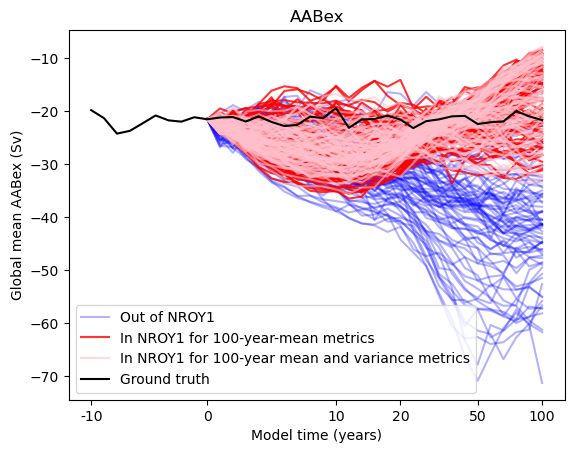

In [40]:
series_year_metric_ocean(pre_e_year_truth, e_year_truth,'AABex','Sv',[["SHI100_START",1, "Out of NROY1"],["ATM-EVO_MEAN_100L",2,"In NROY1 for 100-year-mean metrics"],('ATM-EVO_MV100L',2, 'In NROY1 for 100-year mean and variance metrics')])

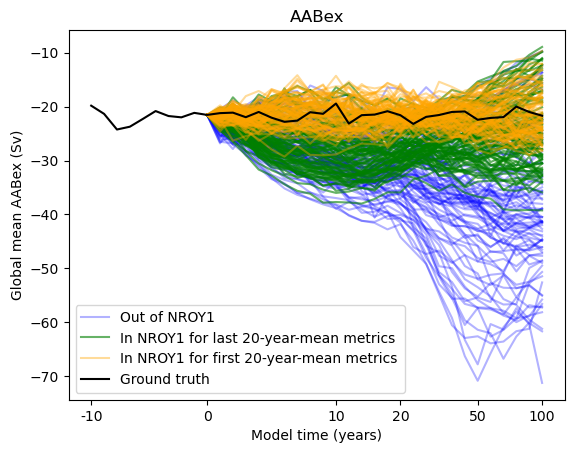

In [18]:
series_year_metric_ocean(pre_e_year_truth, e_year_truth,'AABex','Sv',[["SHI100_START",1, "Out of NROY1"], 
                                                                      ["ATM-EVO_MEAN_100-20L",2,"In NROY1 for last 20-year-mean metrics "],
                                                                      ('100ATM-EVO_MEAN_20L',2, "In NROY1 for first 20-year-mean metrics")])

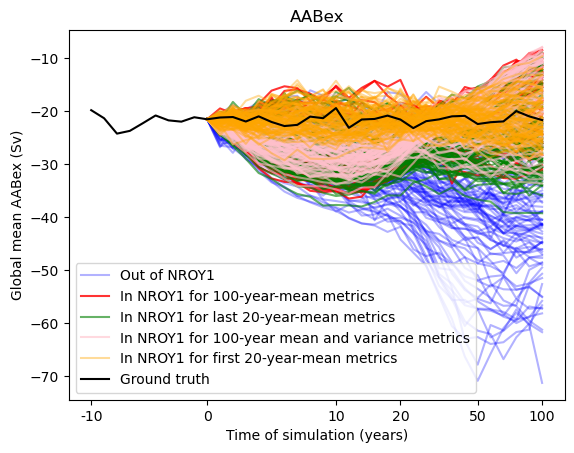

In [85]:
series_year_metric_ocean(pre_e_year_truth, e_year_truth,'AABex','Sv',[["SHI100_START",1, "Out of NROY1"],
                                                                      ["ATM-EVO_MEAN_100L",2,"In NROY1 for 100-year-mean metrics"], 
                                                                      ["ATM-EVO_MEAN_100-20L",2,"In NROY1 for last 20-year-mean metrics "], 
                                                                      ('ATM-EVO_MV100L',2, 'In NROY1 for 100-year mean and variance metrics'), 
                                                                      ('100ATM-EVO_MEAN_20L',2, "In NROY1 for first 20-year-mean metrics")]) #

In [ ]:
ocean_var = [('ADPro','Sv'), ('AABex','Sv'), ('Fc30A','PW'), ('T1mo','°C'), ('S1mo',''), ('VOLN','10 3 km 3 '), ('VOLS','10 3 km 3 '), ('A15N','10 12 km 2 '), ('A15S',"10 12 km 2 ")]
for var_spec in ocean_var:
    var_name, unit = var_spec
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"],["ATM-EVO_MEAN_100L",2,"In NROY1 for 100-year-mean metrics"], ["ATM-EVO_MEAN_100-20L",2,"In NROY1 for last 20-year-mean metrics "], ('ATM-EVO_MV100L',2, 'In NROY1 for 100-year mean and variance metrics')])#, ('100ATM-EVO_MEAN_20L',2, "In NROY1 for first 20-year-mean metrics")]) 
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"], ('ATM-EVO_MV100L',2, 'In NROY1 for 100-year mean and variance metrics'), ('100ATM-EVO_MEAN_20L',2, "In NROY1 for first 20-year-mean metrics")]) #
    

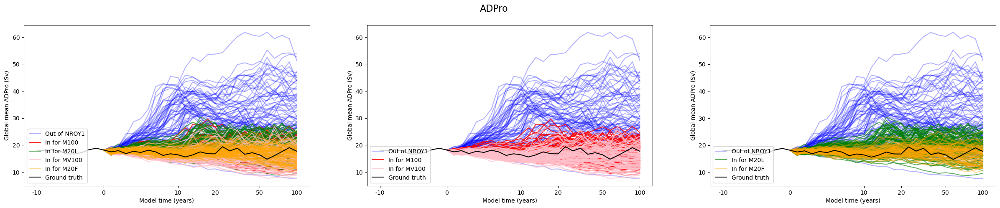

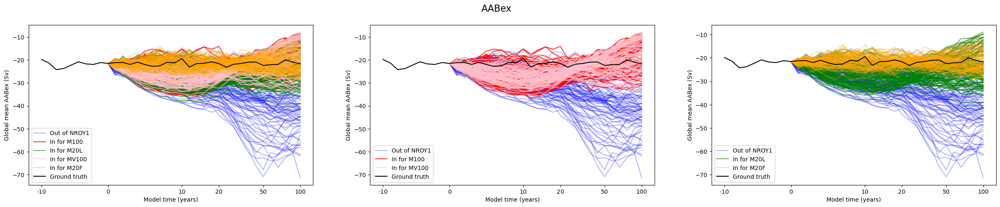

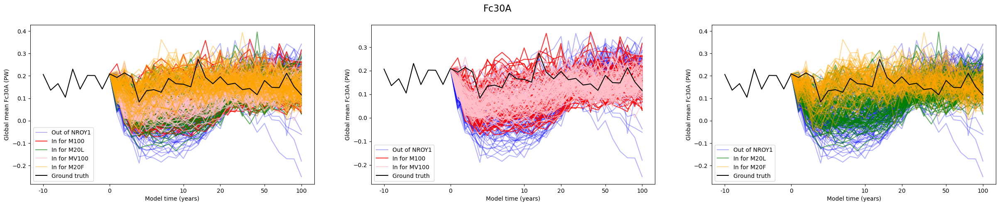

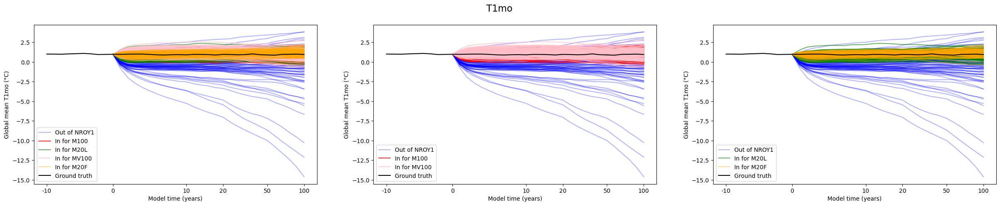

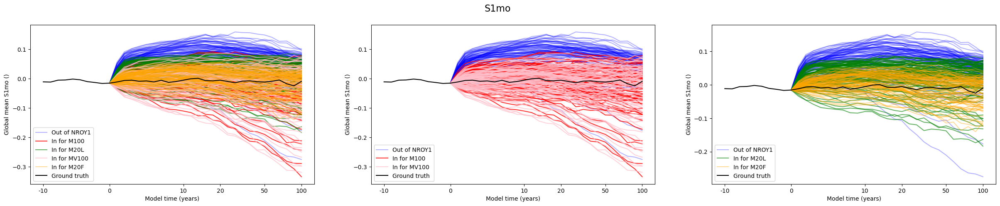

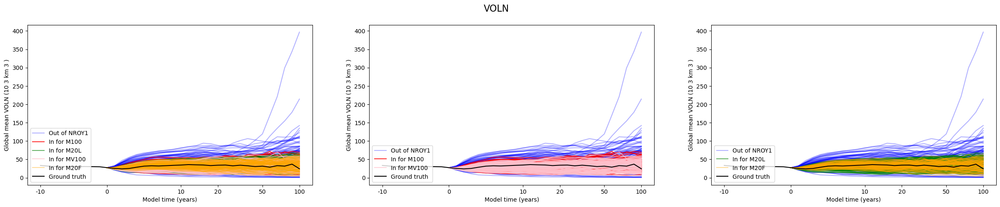

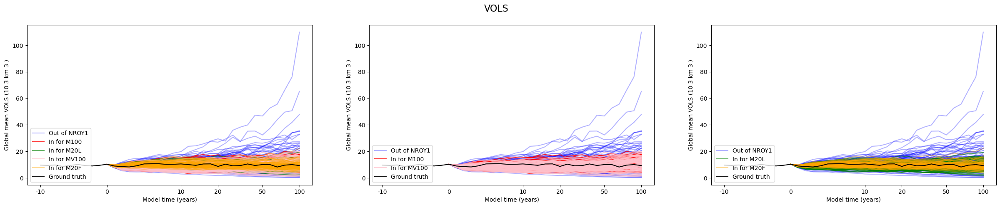

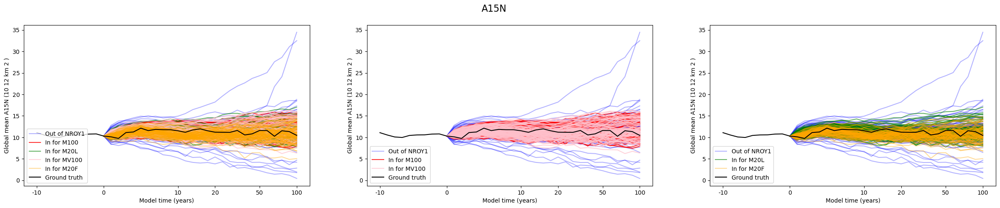

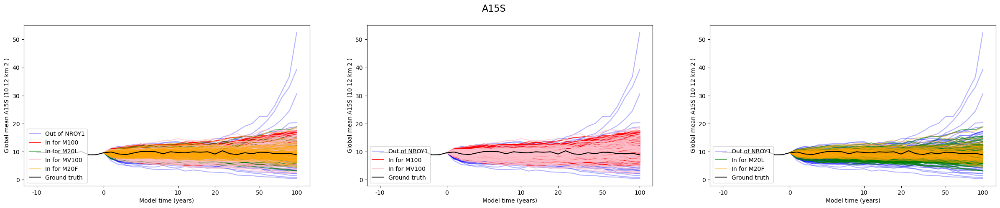

In [64]:
ocean_var = [('ADPro','Sv'), ('AABex','Sv'), ('Fc30A','PW'), ('T1mo','°C'), ('S1mo',''), ('VOLN','10 3 km 3 '), ('VOLS','10 3 km 3 '), ('A15N','10 12 km 2 '), ('A15S',"10 12 km 2 ")]
for var_exp in ocean_var:
    var_name, unit = var_exp
    figure, axes = plt.subplots(1,3,figsize=(30,5))
    
    #locs, labels = axe.set_xticks()  # Get the current locations and labels.
    #axe.set_xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    
    plt.setp(axes, xticks=[0, 9, 19, 24, 30, 35], xticklabels= ['-10', '0', '10', '20', '50', '100'])
    
    
    figure.suptitle(f'{var_name}', fontsize=16)
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"],
                                                                  ["ATM-EVO_MEAN_100L",2,"In for M100"], 
                                                                  ["ATM-EVO_MEAN_100-20L",2,"In for M20L"], 
                                                                  ('ATM-EVO_MV100L',2, 'In for MV100'), 
                                                                  ('100ATM-EVO_MEAN_20L',2, "In for M20F")], axe=axes[0]) #
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"],
                                                                           ["ATM-EVO_MEAN_100L",2,"In for M100"], 
                                                                           ('ATM-EVO_MV100L',2, 'In for MV100')], axe=axes[1])#, ('100ATM-EVO_MEAN_20L',2, "In NROY1 for first 20-year-mean metrics")]) 

    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"], 
                                                                          ["ATM-EVO_MEAN_100-20L",2,"In for M20L "],
                                                                          ('100ATM-EVO_MEAN_20L',2, "In for M20F")], axe=axes[2])
    plt.show()

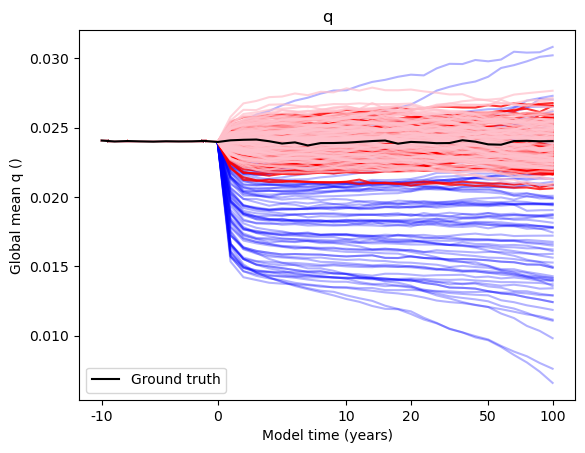

In [71]:
series_year_metric_atm(pre_a_year_truth, a_year_truth,'q','',[["SHI100_START",1, "Out of NROY1"],["ATM-EVO_MEAN_100L",2,"In NROY1 for 100-year-mean metrics"],('ATM-EVO_MV100L',2, 'In NROY1 for 100-year mean and variance metrics')])

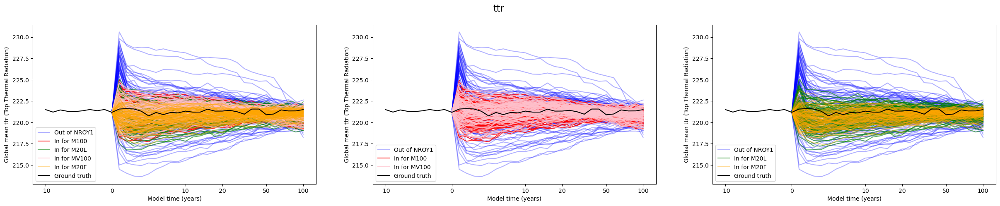

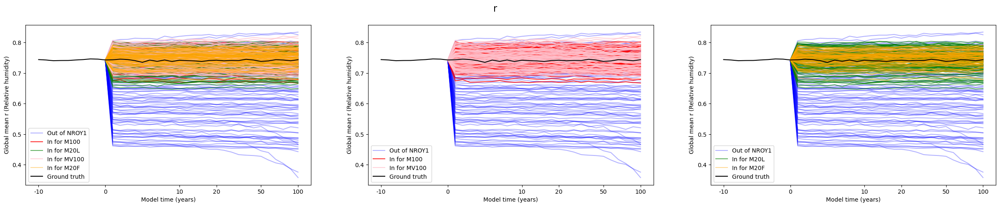

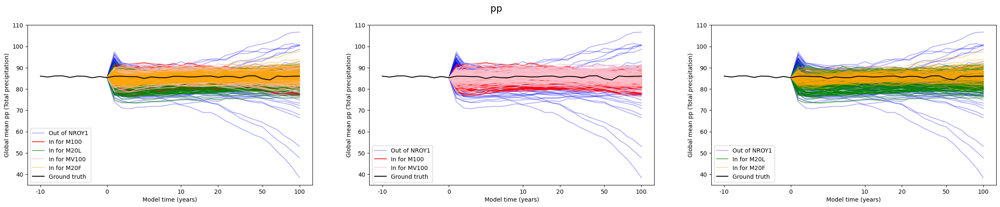

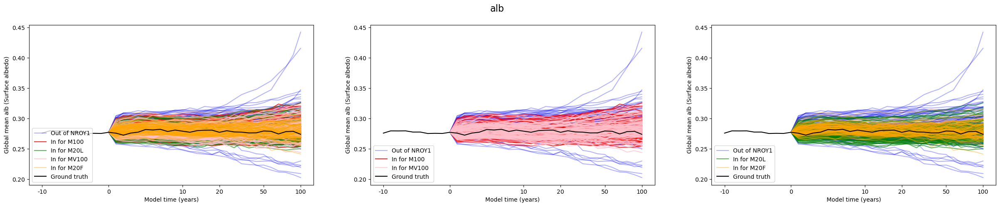

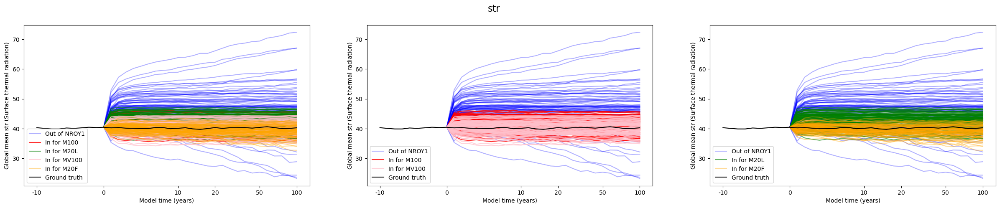

In [12]:
atm_var = [('ttr','Top Thermal Radiation'),('r','Relative humidity'), ('pp','Total precipitation'), ('alb','Surface albedo'),('str', 'Surface thermal radiation')]
for var_exp in atm_var:
    var_name, unit = var_exp
    figure, axes = plt.subplots(1,3,figsize=(30,5))
    
    #locs, labels = axe.set_xticks()  # Get the current locations and labels.
    #axe.set_xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    
    plt.setp(axes, xticks=[0, 9, 19, 24, 30, 35], xticklabels= ['-10', '0', '10', '20', '50', '100'])
    
    
    figure.suptitle(f'{var_name}', fontsize=16)
    series_year_metric_atm(pre_a_year_truth, a_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"],
                                                                  ["ATM-EVO_MEAN_100L",2,"In for M100"], 
                                                                  ["ATM-EVO_MEAN_100-20L",2,"In for M20L"], 
                                                                  ('ATM-EVO_MV100L',2, 'In for MV100'), 
                                                                  ('100ATM-EVO_MEAN_20L',2, "In for M20F")], axe=axes[0]) #
    series_year_metric_atm(pre_a_year_truth, a_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"],
                                                                           ["ATM-EVO_MEAN_100L",2,"In for M100"], 
                                                                           ('ATM-EVO_MV100L',2, 'In for MV100')], axe=axes[1])#, ('100ATM-EVO_MEAN_20L',2, "In NROY1 for first 20-year-mean metrics")]) 

    series_year_metric_atm(pre_a_year_truth, a_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"], 
                                                                          ["ATM-EVO_MEAN_100-20L",2,"In for M20L "],
                                                                          ('100ATM-EVO_MEAN_20L',2, "In for M20F")], axe=axes[2])
    plt.show()

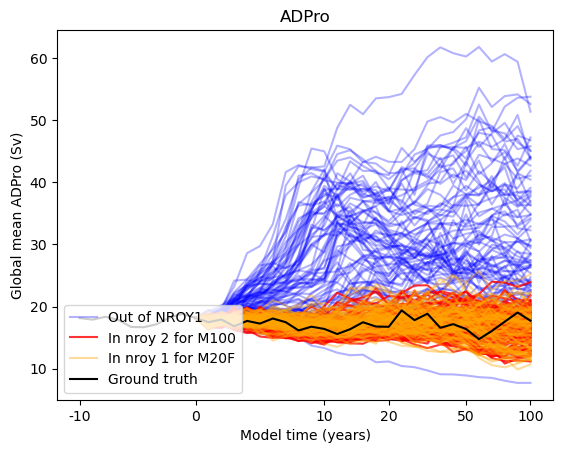

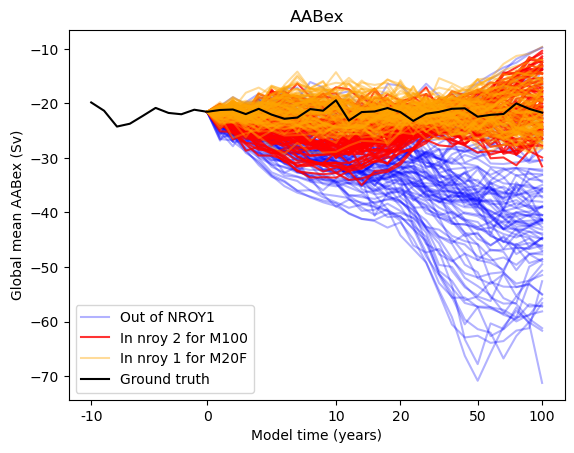

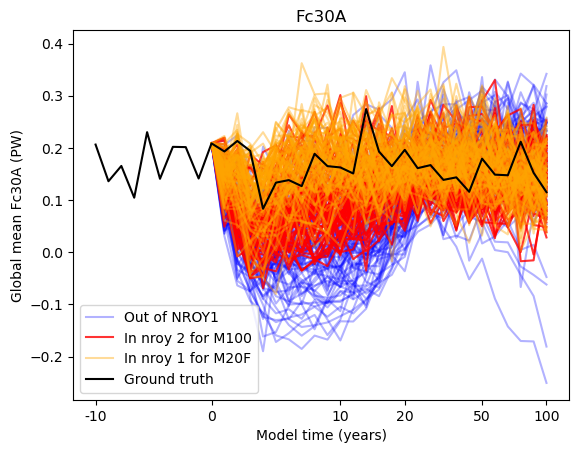

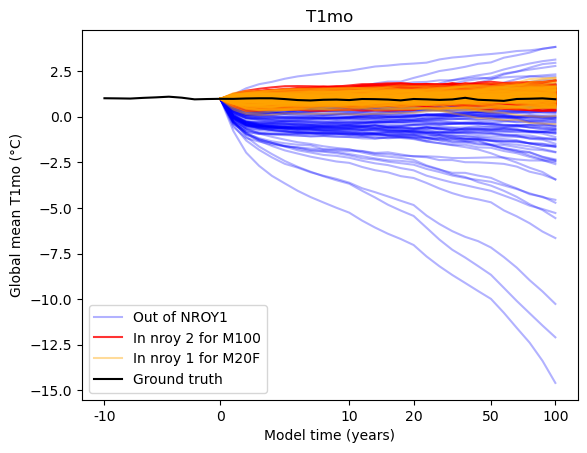

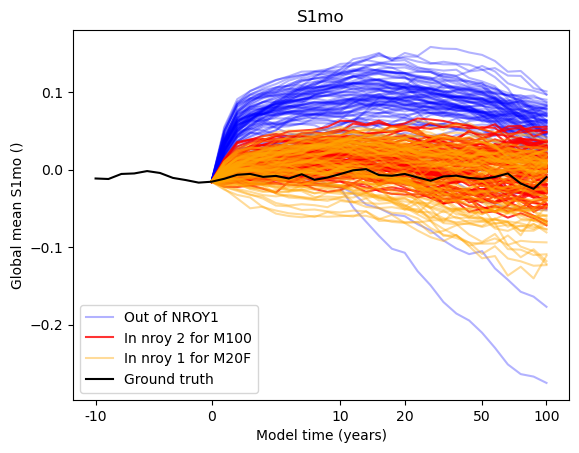

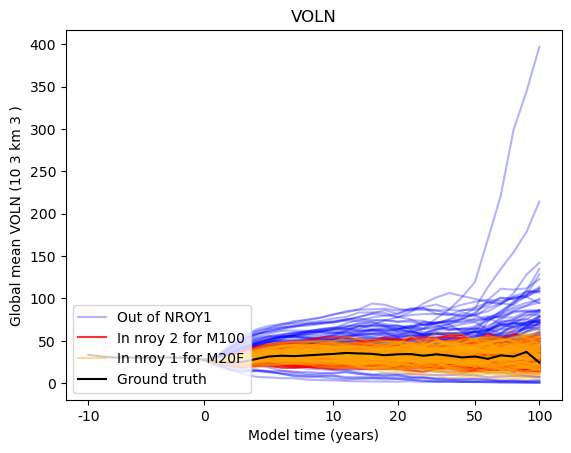

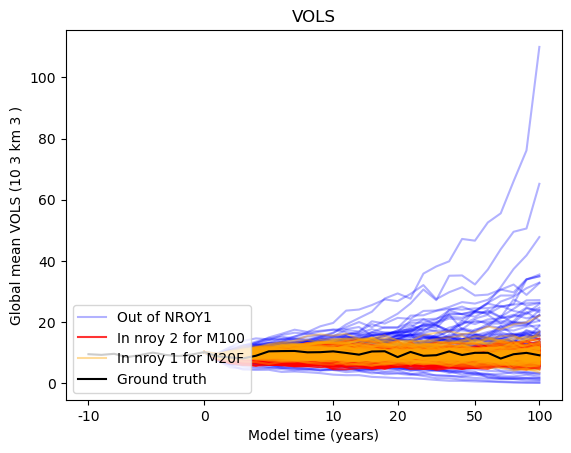

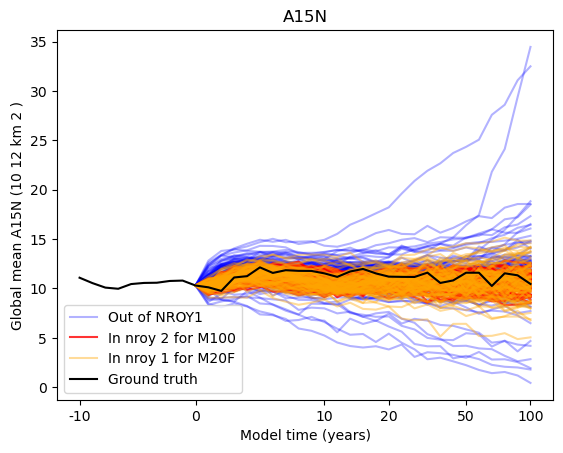

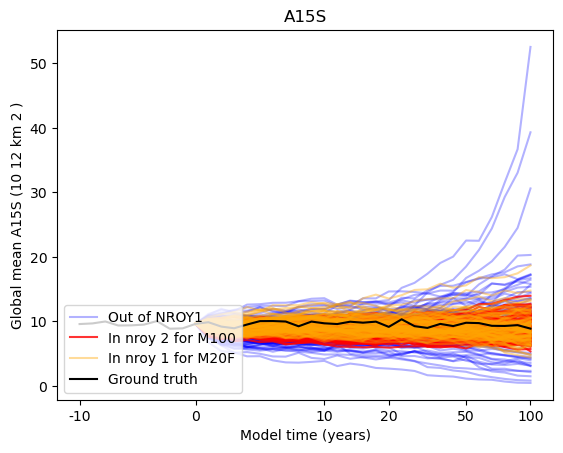

In [15]:
ocean_var = [('ADPro','Sv'), ('AABex','Sv'), ('Fc30A','PW'), ('T1mo','°C'), ('S1mo',''), ('VOLN','10 3 km 3 '), ('VOLS','10 3 km 3 '), ('A15N','10 12 km 2 '), ('A15S',"10 12 km 2 ")]
for var_spec in ocean_var:
    var_name, unit = var_spec
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"],["ATM-EVO_MEAN_100L",3,"In nroy 2 for M100"], ('100ATM-EVO_MEAN_20L',2, "In nroy 1 for M20F")]) 
    #series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["SHI100_START",1, "Out of NROY1"], ('ATM-EVO_MV100L',2, 'In NROY1 for 100-year mean and variance metrics'), ('100ATM-EVO_MEAN_20L',2, "In NROY1 for first 20-year-mean metrics")]) #
    

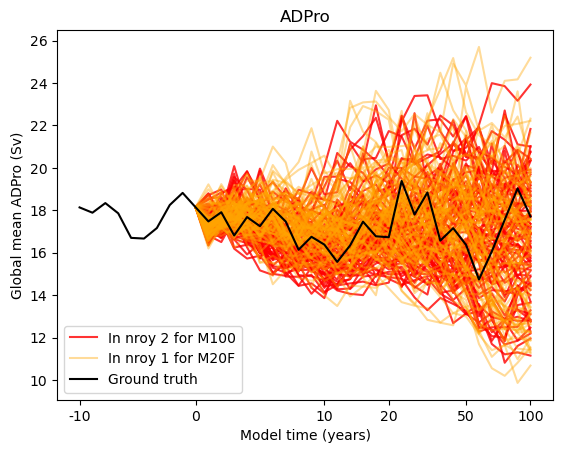

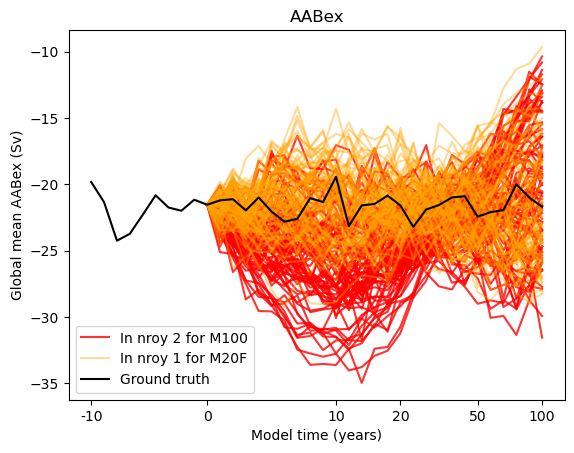

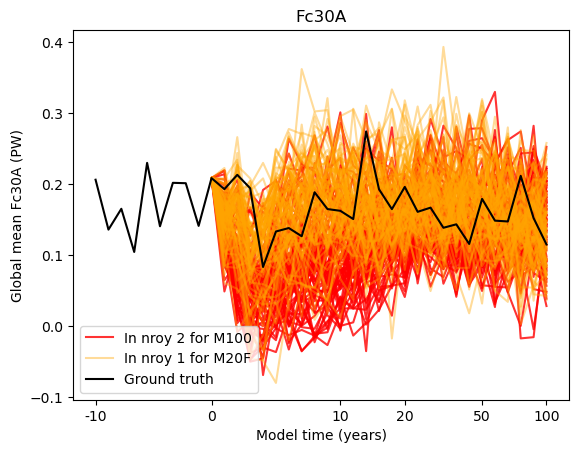

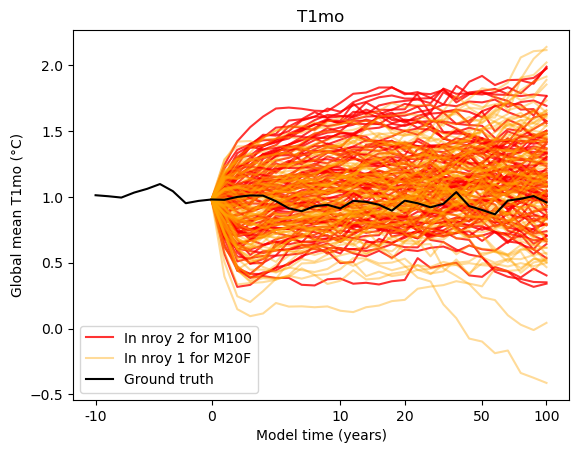

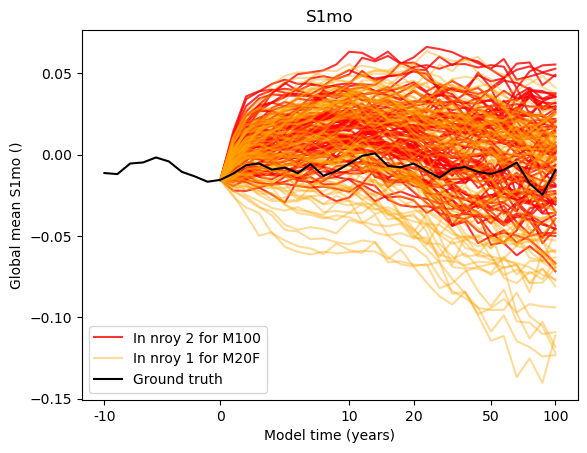

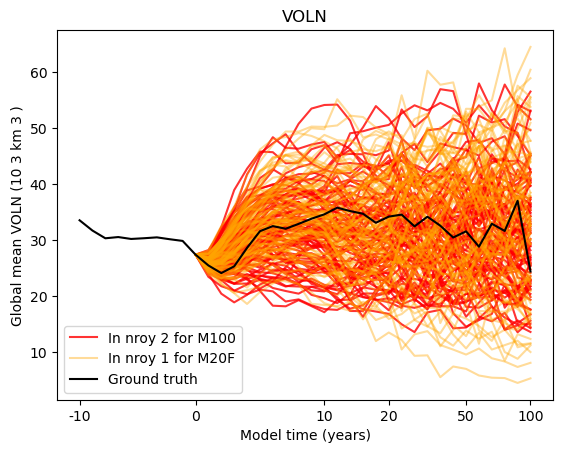

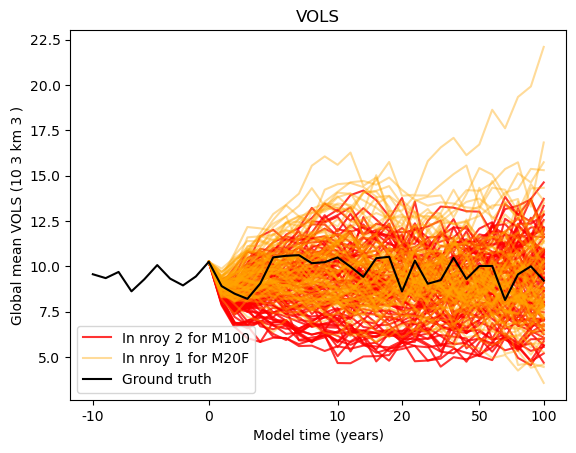

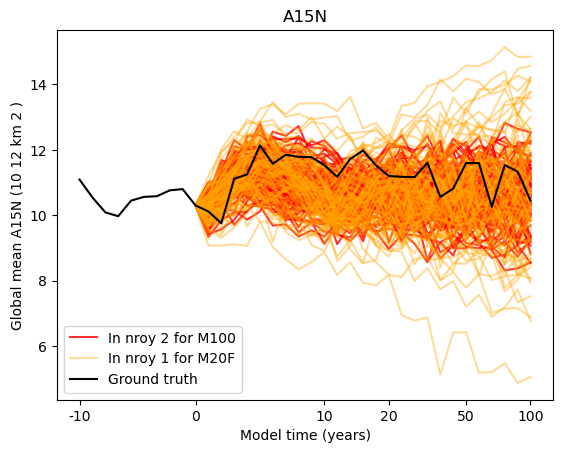

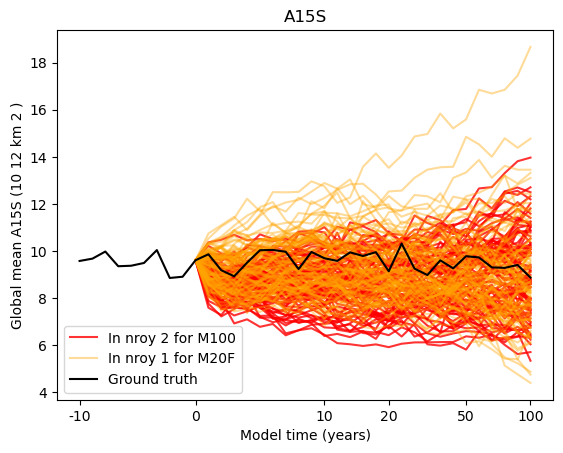

In [16]:
ocean_var = [('ADPro','Sv'), ('AABex','Sv'), ('Fc30A','PW'), ('T1mo','°C'), ('S1mo',''), ('VOLN','10 3 km 3 '), ('VOLS','10 3 km 3 '), ('A15N','10 12 km 2 '), ('A15S',"10 12 km 2 ")]
for var_spec in ocean_var:
    var_name, unit = var_spec
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[#["100ATM-EVO_MEAN_20L_CANDIDATE1",0, "M20_k1"],
                                                                           ["ATM-EVO_MEAN_100L",3,"In nroy 2 for M100"], 
                                                                           ('100ATM-EVO_MEAN_20L',2, "In nroy 1 for M20F")]) 

    

### Candidates

In [12]:
def series_year_metric_ocean(pre_ds_truth, ds_truth,variable,unit, list_exp, axe=None, n_param=9, sample_size=10):
    if axe == None:
        plt.figure()
        plt.title(variable)
        plt.xlabel("Model time (years)")
        plt.ylabel(f"Global mean {variable} ({unit})")

        locs, labels = plt.xticks()  # Get the current locations and labels.
        plt.xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    else:
        #axe.set_title(variable)
        axe.set_xlabel("Model time (years)")
        axe.set_ylabel(f"Global mean {variable} ({unit})")

    
    # for simulations 
    truth_metric = ds_truth[variable][:]
    pre_ticks =[-10,-9,-8,-7,-6,-5,-4,-3,-2,-1]
    x_ticks = [k for k in range(10)]+[k for k in range(11,20,2)]+ [k for k in range(24,50,5)]+ [k for k in range(59,101,10)]
    ticks = pre_ticks + x_ticks
    root = '/homedata/mjanvier/iloveclim/wkdir'
    results = []
    indices_simu = []
    fails = []
    nan_array = np.empty(9)
    nan_array.fill(np.NaN)
    for param in list_exp:
        exp = param[0]
        nb_wave = param[1]
        exp_label = param[2]
        if exp =="SHI100_START":
            color = 'blue'
            alpha = 0.3
        elif exp == "100ATM-EVO_MEAN_20L":
            color = 'orange'
            alpha = 0.4
        elif exp == "ATM-EVO_MEAN_100L":
            color = 'red'
            alpha = 0.8
        elif exp == "ATM-EVO_MEAN_100-20L":
            color = 'green'
            alpha = 0.6
        elif exp == "ATM-EVO_MV100L":
            color = 'pink'
            alpha = 0.7
        if axe is None:
            for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
                path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
                if os.path.exists(path_evolu):
                    _, e_year_var = get_evolution_evolu(path_evolu,100,[variable])
                    if n_simu % 90 == 1:
                        plt.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],e_year_var[variable][x_ticks]]),label=f'{exp_label}', alpha=0.5)
                    else:
                        plt.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],e_year_var[variable][x_ticks]]), label=f'{exp_label}', alpha=0.5)
            


        else:
            for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
                path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
                if os.path.exists(path_evolu):
                    _, e_year_var = get_evolution_evolu(path_evolu,100,[variable])
                    if n_simu % 90 == 1:
                        axe.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],e_year_var[variable][x_ticks]]),label=f'{exp_label}', alpha=0.5)
                    else:
                        axe.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],e_year_var[variable][x_ticks]]), label=f'{exp_label}',alpha=0.5)
                    
    if axe == None:
        plt.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
        plt.legend(loc='lower left')
        plt.show()
                            
    else:    
        axe.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
        axe.legend(loc='lower left')

                  

In [28]:
def series_year_metric_atm(pre_ds_truth, ds_truth,variable,unit, list_exp, axe=None, n_param=9, sample_size=10):
    if axe == None:
        plt.figure()
        plt.title(variable)
        plt.xlabel("Model time (years)")
        plt.ylabel(f"Global mean {variable} ({unit})")

        locs, labels = plt.xticks()  # Get the current locations and labels.
        plt.xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    else:
        #axe.set_title(variable)
        axe.set_xlabel("Model time (years)")
        axe.set_ylabel(f"Global mean {variable} ({unit})")

    
    # for simulations 
    truth_metric = ds_truth[variable][:]
    pre_ticks =[-10,-9,-8,-7,-6,-5,-4,-3,-2,-1]
    x_ticks = [k for k in range(10)]+[k for k in range(11,20,2)]+ [k for k in range(24,50,5)]+ [k for k in range(59,101,10)]
    ticks = pre_ticks + x_ticks
    root = '/homedata/mjanvier/iloveclim/wkdir'
    results = []
    indices_simu = []
    fails = []
    nan_array = np.empty(9)
    nan_array.fill(np.NaN)
    for param in list_exp:
        exp = param[0]
        nb_wave = param[1]
        exp_label = param[2]
        if exp =="SHI100_START":
            color = 'blue'
            alpha = 0.3
        elif exp == "100ATM-EVO_MEAN_20L":
            color = 'orange'
            alpha = 0.4
        elif exp == "ATM-EVO_MEAN_100L":
            color = 'red'
            alpha = 0.8
        elif exp == "ATM-EVO_MEAN_100-20L":
            color = 'green'
            alpha = 0.6
        elif exp == "ATM-EVO_MV100L":
            color = 'pink'
            alpha = 0.7
        if axe is None:
            for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
                path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
                if os.path.exists(path_evolu):
                    path_atmos = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/atmos/atmym008000.nc'
                    a_year_var = get_evolution_atmos(path_atmos,100,[variable])
                    
                if not '100' in exp:
                    nan_array = np.empty(80)
                    nan_array.fill(np.NaN)
                    a_year_var[variable] = np.concatenate([a_year_var[variable],nan_array])

                plt.plot(np.concatenate([pre_ds_truth[variable][-10:],a_year_var[variable][x_ticks]]),label=f'{exp_label}',alpha=0.5)
                

        else:
            for n_simu in range((nb_wave-1)*n_param*sample_size+1, nb_wave*n_param*sample_size+1):
                path_evolu = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/ocean/myevolu.nc'
                if os.path.exists(path_evolu):
                    path_atmos = root+f'/{exp}{n_simu}_ecbilt_clio/run/outputdata/atmos/atmym008000.nc'
                    a_year_var = get_evolution_atmos(path_atmos,100,[variable])
                    #if not '100' in exp:
                        #nan_array = np.empty(80)
                        #nan_array.fill(np.NaN)
                        #a_year_var[variable] = np.concatenate([a_year_var[variable],nan_array])

                    if n_simu % 90 == 1:
                        axe.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],a_year_var[variable][x_ticks]]), alpha=0.5, label=f'{exp_label}')
                    else:
                        axe.plot(np.concatenate([nan_array,pre_ds_truth[variable][-1:],a_year_var[variable][x_ticks]]),alpha=0.5, label=f'{exp_label}')
                    
    if axe == None:
        plt.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
        plt.legend(loc='lower left')
        plt.show()
                            
    else:    
        axe.plot(np.concatenate([pre_ds_truth[variable][-10:],truth_metric[x_ticks]]), label=f'Ground truth', color='black')
        axe.legend(loc='lower left')

                  

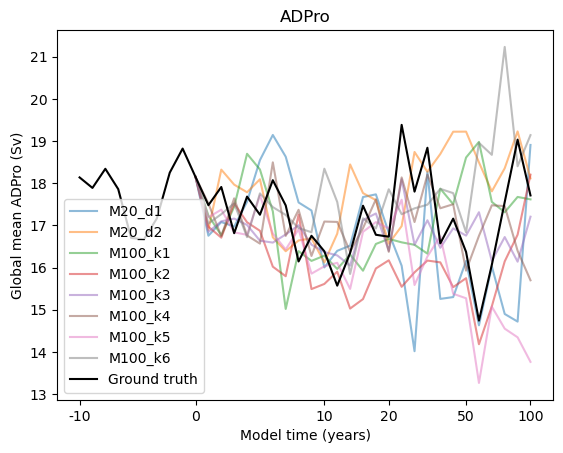

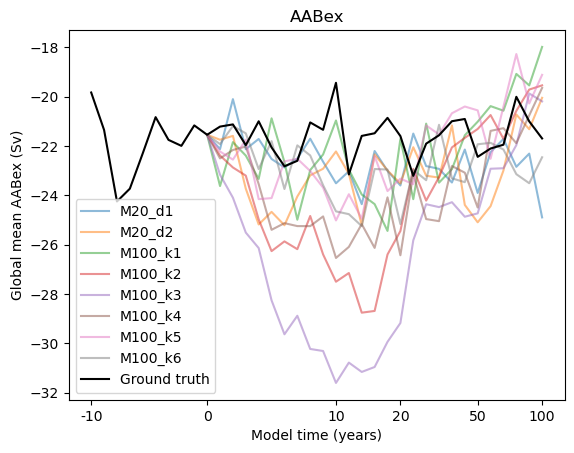

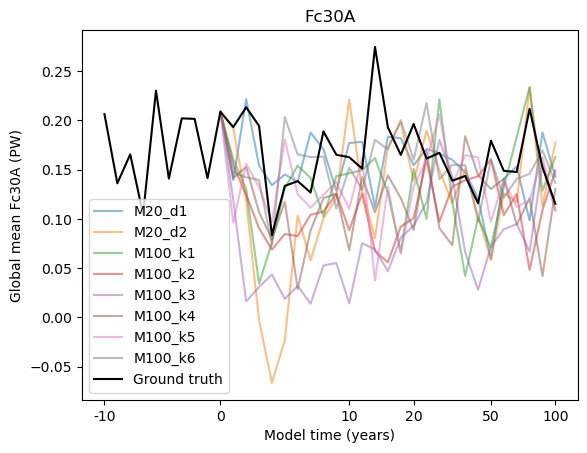

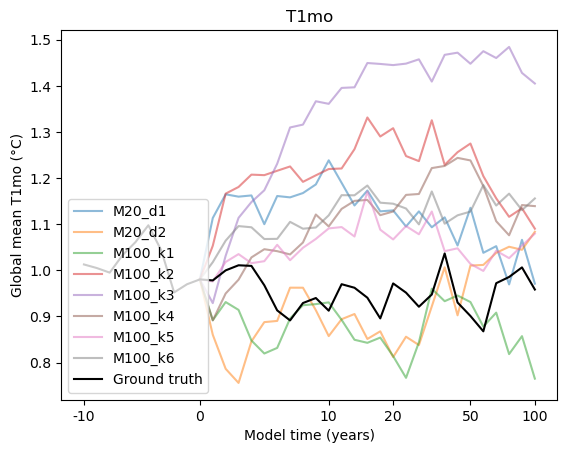

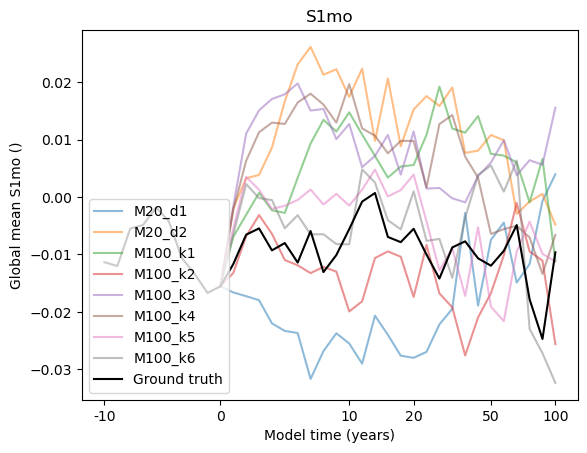

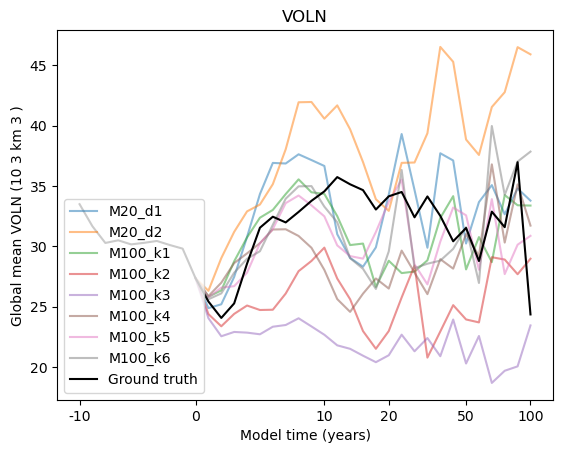

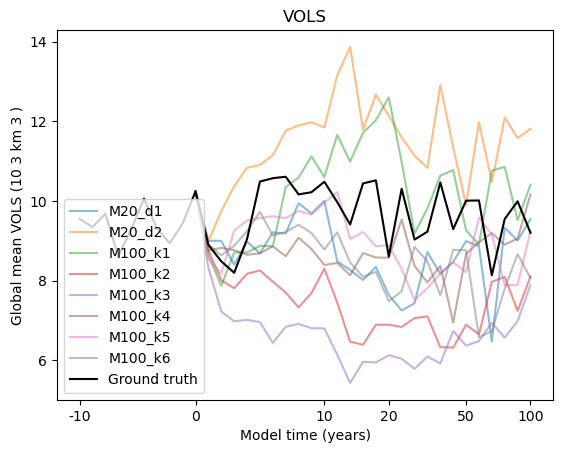

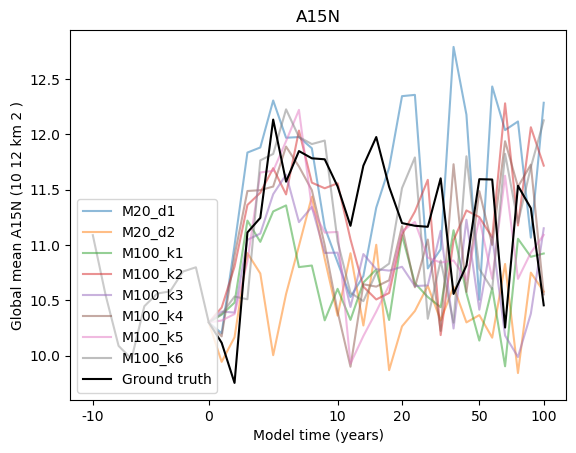

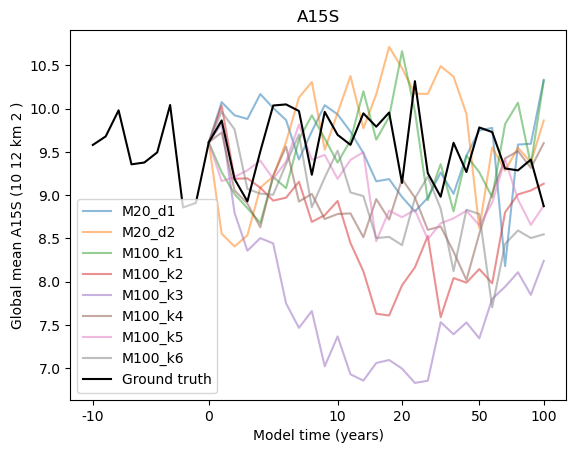

In [14]:
ocean_var = [('ADPro','Sv'), ('AABex','Sv'), ('Fc30A','PW'), ('T1mo','°C'), ('S1mo',''), ('VOLN','10 3 km 3 '), ('VOLS','10 3 km 3 '), ('A15N','10 12 km 2 '), ('A15S',"10 12 km 2 ")]
for var_spec in ocean_var:
    var_name, unit = var_spec
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["100ATM-EVO_MEAN_20L_CANDIDATE",1, "M20_d1"],
                                                                           ["100ATM-EVO_MEAN_20L_CANDIDATE",2,"M20_d2"], 
                                                                           #('100ATM-EVO_MEAN_20L_CANDIDATE1W2',1, "M20_k2"),
                                                                          #('100ATM-EVO_MEAN_20L_CANDIDATE1W8',1, "M20_k8"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',1,"M100_k1"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',2,"M100_k2"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',3,"M100_k3"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',4,"M100_k4"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',5,"M100_k5"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',6,"M100_k6")],n_param=1, sample_size=1) 

    

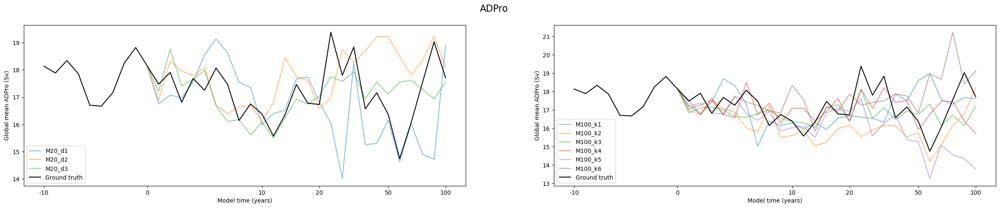

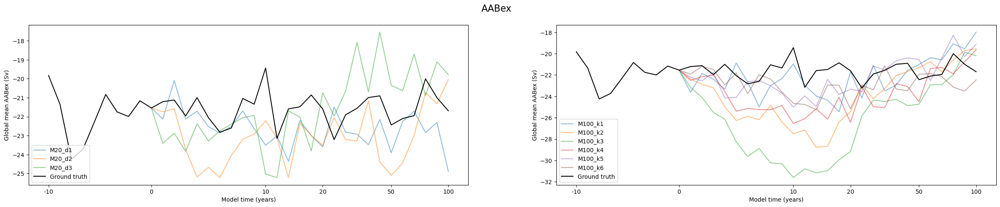

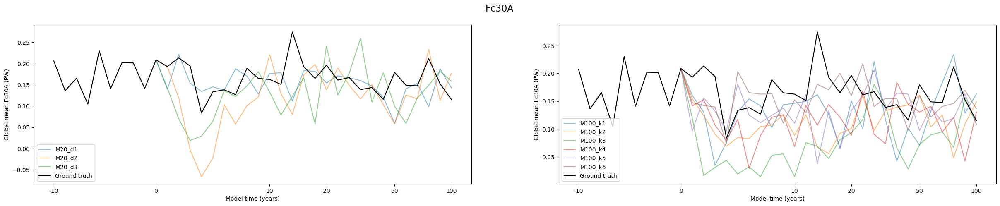

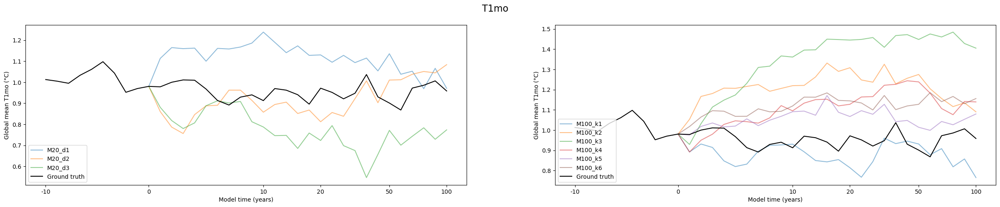

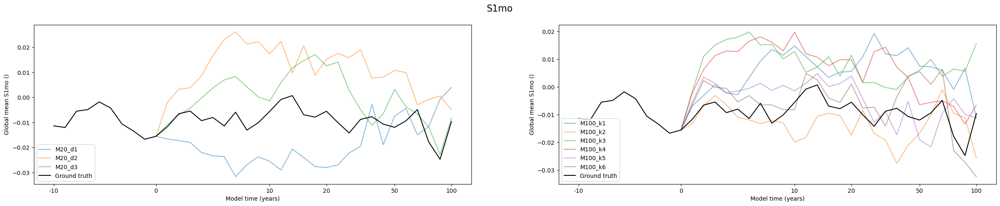

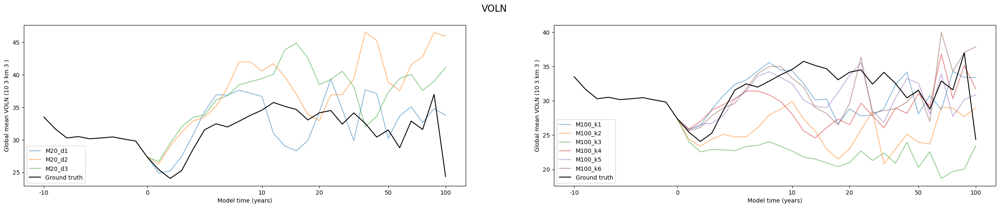

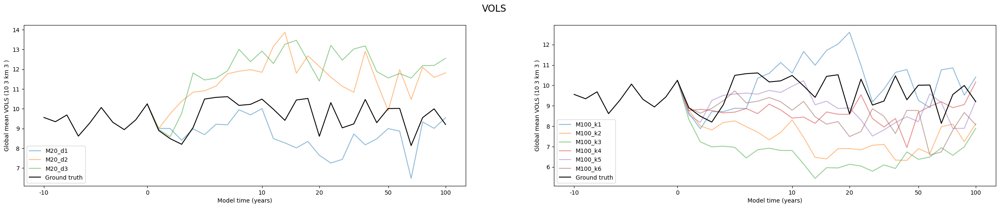

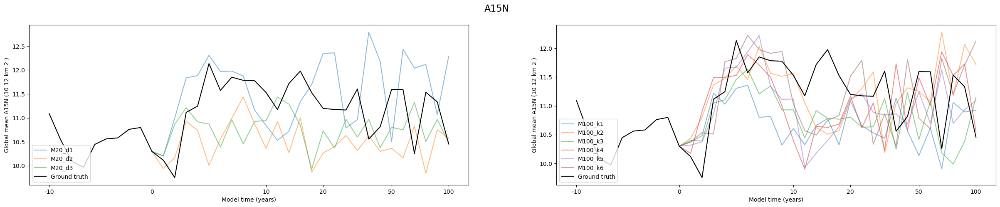

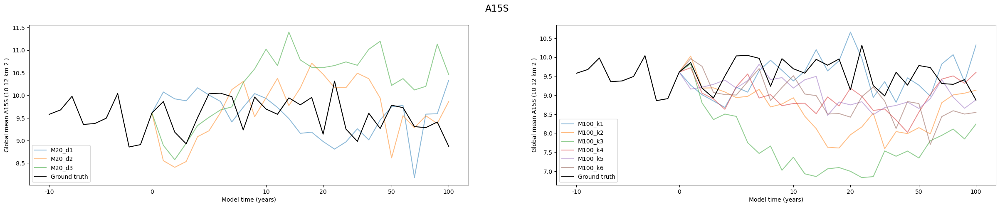

In [15]:
for var_exp in ocean_var:
    var_name, unit = var_exp
    figure, axes = plt.subplots(1,3,figsize=(30,5))
    
    #locs, labels = axe.set_xticks()  # Get the current locations and labels.
    #axe.set_xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    
    plt.setp(axes, xticks=[0, 9, 19, 24, 30, 35], xticklabels= ['-10', '0', '10', '20', '50', '100'])
    
    
    figure.suptitle(f'{var_name}', fontsize=16)
    
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["100ATM-EVO_MEAN_20L_CANDIDATE",1, "M20_d1"],
                                                                           ["100ATM-EVO_MEAN_20L_CANDIDATE",2,"M20_d2"],
                                                                          ["100ATM-EVO_MEAN_20L_CANDIDATE",3,"M20_d3"]],n_param=1, sample_size=1, axe=axes[0]) 
    
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[('ATM-EVO_MEAN_100L_CANDIDATE',1,"M100_k1"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',2,"M100_k2"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',3,"M100_k3"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',4,"M100_k4"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',5,"M100_k5"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',6,"M100_k6")],n_param=1, sample_size=1, axe=axes[1]) 
                                                                         
    

In [ ]:
# with M20K

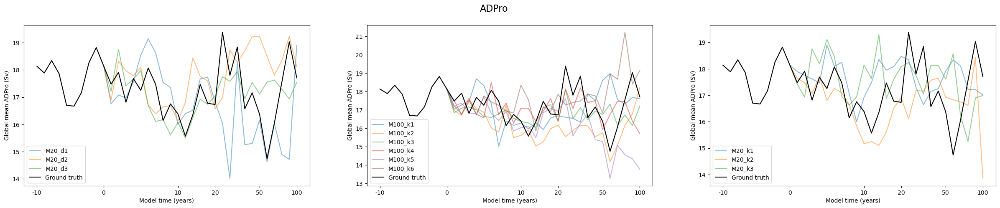

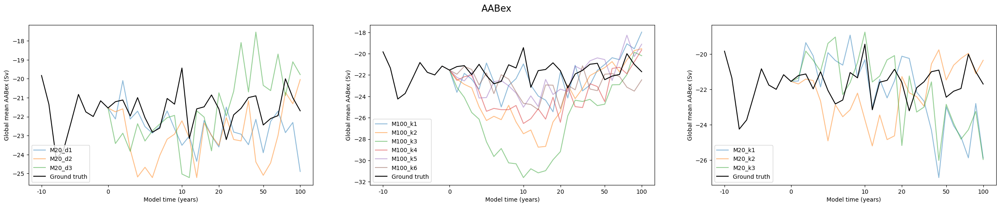

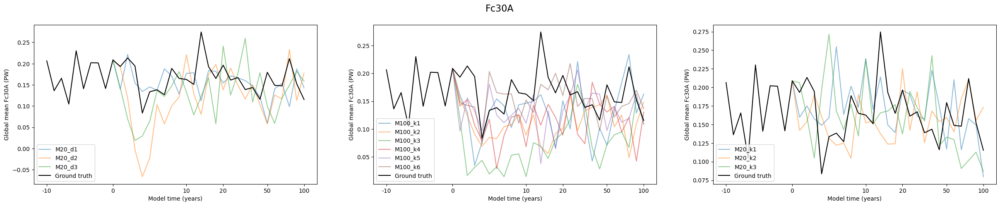

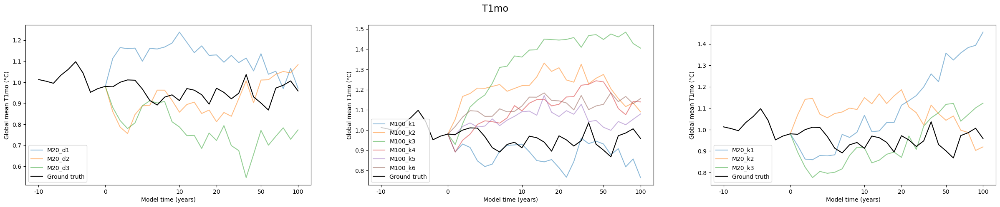

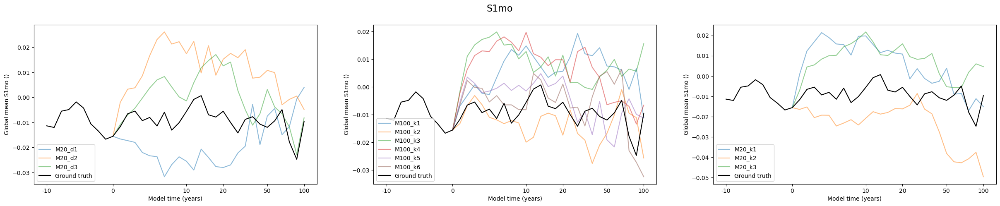

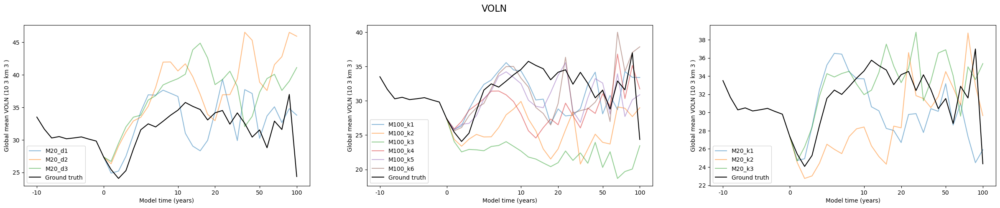

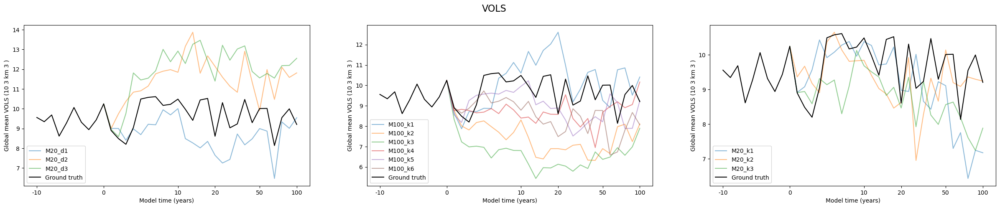

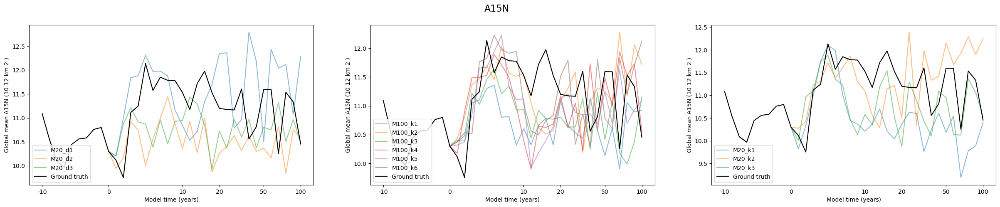

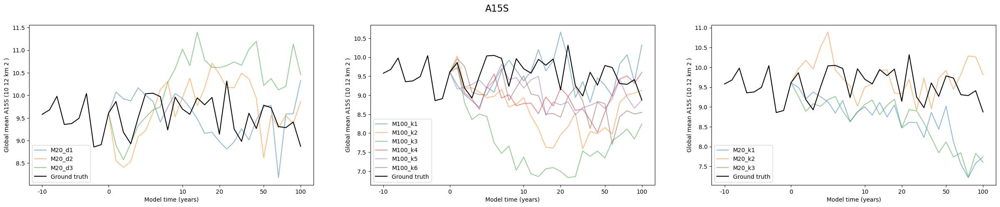

In [20]:
for var_exp in ocean_var:
    var_name, unit = var_exp
    figure, axes = plt.subplots(1,3,figsize=(30,5))
    
    #locs, labels = axe.set_xticks()  # Get the current locations and labels.
    #axe.set_xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    
    plt.setp(axes, xticks=[0, 9, 19, 24, 30, 35], xticklabels= ['-10', '0', '10', '20', '50', '100'])
    
    
    figure.suptitle(f'{var_name}', fontsize=16)
    
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["100ATM-EVO_MEAN_20L_CANDIDATE",1, "M20_d1"],
                                                                           ["100ATM-EVO_MEAN_20L_CANDIDATE",2,"M20_d2"],
                                                                          ["100ATM-EVO_MEAN_20L_CANDIDATE",3,"M20_d3"]],n_param=1, sample_size=1, axe=axes[0])
    
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[["ATM-EVO_MEAN_20L_opt6_candidates_wave_1",1, "M20_k1"],
                                                                           ["ATM-EVO_MEAN_20L_opt6_candidates_wave_1",2,"M20_k2"],
                                                                          ["ATM-EVO_MEAN_20L_opt6_candidates_wave_1",3,"M20_k3"]],n_param=1, sample_size=1, axe=axes[2]) 
    
    series_year_metric_ocean(pre_e_year_truth, e_year_truth,var_name,unit,[('ATM-EVO_MEAN_100L_CANDIDATE',1,"M100_k1"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',2,"M100_k2"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',3,"M100_k3"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',4,"M100_k4"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',5,"M100_k5"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',6,"M100_k6")],n_param=1, sample_size=1, axe=axes[1]) 
                                                                         
    

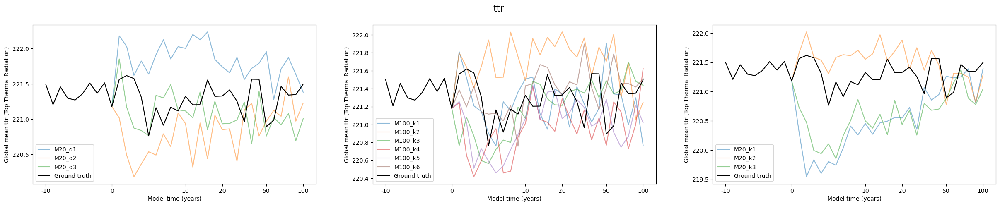

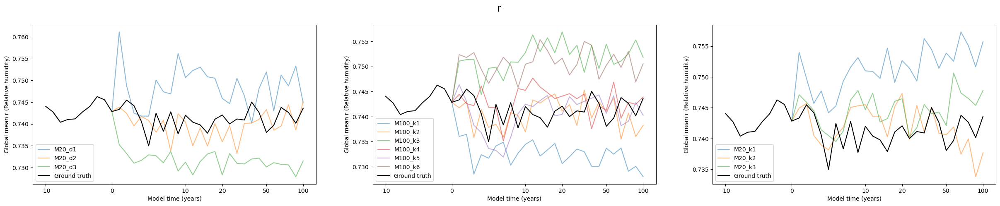

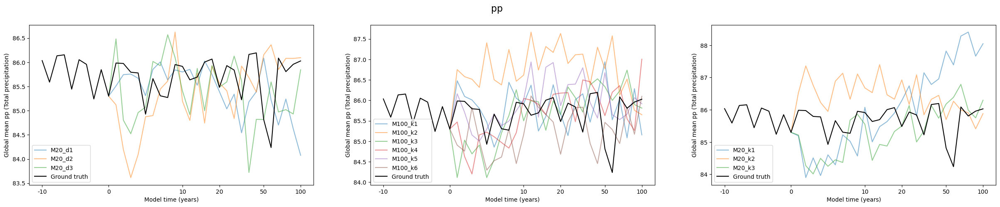

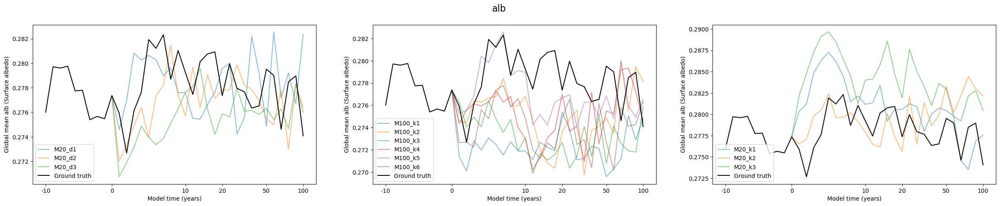

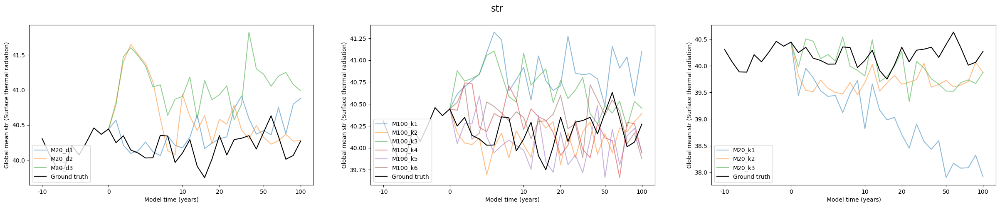

...

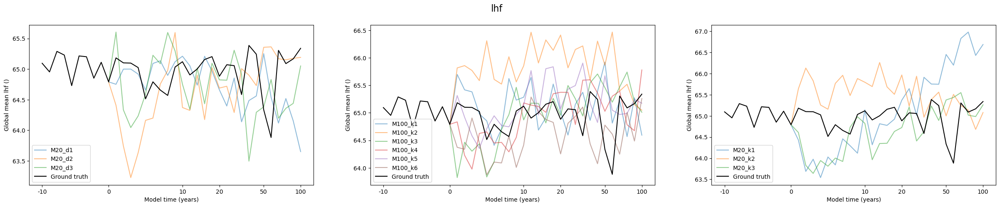

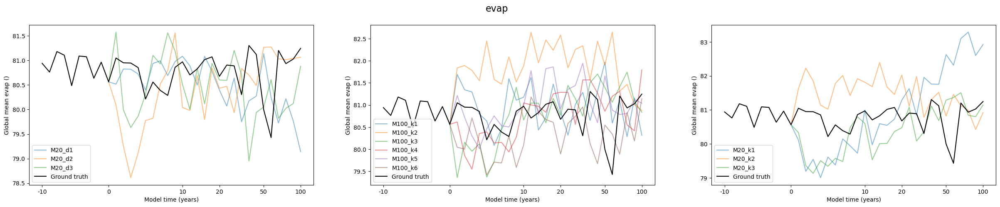

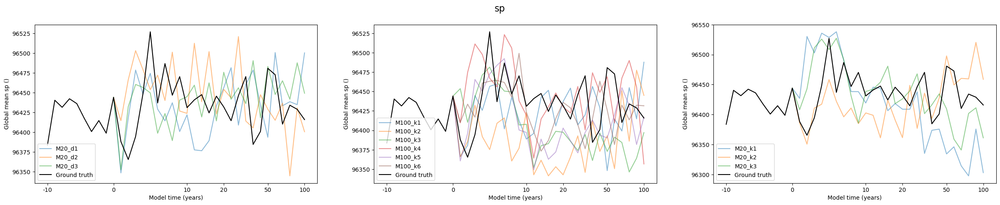

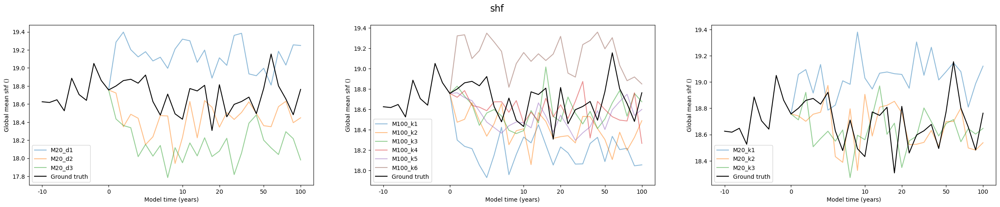

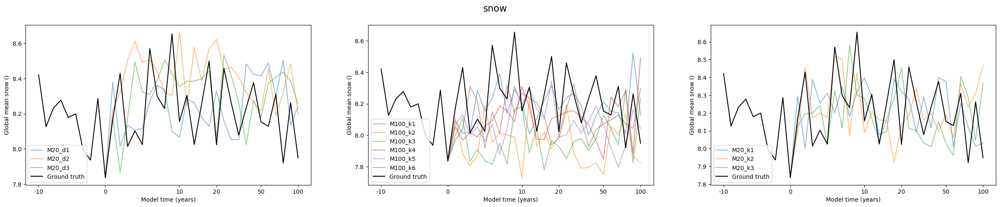

In [29]:
#atm_var = ['q', 'ts', 'r', 'ssr', 'tsr', 'ttr', 'evap', 'pp', 'lhf',  'alb', 'sp','shf', 'str', 'snow', 'bm']
atm_var = [('ttr','Top Thermal Radiation'),('r','Relative humidity'), ('pp','Total precipitation'), ('alb','Surface albedo'),('str', 'Surface thermal radiation'),('bm',""),('q',""),('ts',""),('ssr',""),('tsr',""),('lhf',""),('evap',""),('sp',""), ('shf',""),('snow',"")]
for var_exp in atm_var:
    var_name, unit = var_exp
    figure, axes = plt.subplots(1,3,figsize=(30,5))
    
    #locs, labels = axe.set_xticks()  # Get the current locations and labels.
    #axe.set_xticks([0, 9, 19, 24, 30, 35], ['-10', '0', '10', '20', '50', '100'])
    
    plt.setp(axes, xticks=[0, 9, 19, 24, 30, 35], xticklabels= ['-10', '0', '10', '20', '50', '100'])
    
    
    figure.suptitle(f'{var_name}', fontsize=16)
    series_year_metric_atm(pre_a_year_truth, a_year_truth,var_name,unit,[["100ATM-EVO_MEAN_20L_CANDIDATE",1, "M20_d1"],
                                                                           ["100ATM-EVO_MEAN_20L_CANDIDATE",2,"M20_d2"],
                                                                          ["100ATM-EVO_MEAN_20L_CANDIDATE",3,"M20_d3"]],n_param=1, sample_size=1, axe=axes[0]) 
    
    
    series_year_metric_atm(pre_a_year_truth, a_year_truth,var_name,unit,[["ATM-EVO_MEAN_20L_opt6_candidates_wave_1",1, "M20_k1"],
                                                                           ["ATM-EVO_MEAN_20L_opt6_candidates_wave_1",2,"M20_k2"],
                                                                        ["ATM-EVO_MEAN_20L_opt6_candidates_wave_1",3,"M20_k3"]],n_param=1, sample_size=1, axe=axes[2]) 
    
    series_year_metric_atm(pre_a_year_truth, a_year_truth,var_name,unit,[('ATM-EVO_MEAN_100L_CANDIDATE',1,"M100_k1"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',2,"M100_k2"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',3,"M100_k3"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',4,"M100_k4"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',5,"M100_k5"),
                                                                          ('ATM-EVO_MEAN_100L_CANDIDATE',6,"M100_k6")],n_param=1, sample_size=1, axe=axes[1]) 
                                                                         
    